# Example of Style Transfer

The training can take a significant time so it's recommended to run this on Google Colaboratory.



## Before you run this code you will need to download the 'imagenet-vgg-verydeep-19.mat' file and put it to the same folder with this file.
You can download it from here: 
https://dl.dropboxusercontent.com/u/108721752/imagenet-vgg-verydeep-19.mat

In [1]:
!wget http://www.vlfeat.org/matconvnet/models/beta16/imagenet-vgg-verydeep-19.mat

--2019-06-19 22:42:13--  http://www.vlfeat.org/matconvnet/models/beta16/imagenet-vgg-verydeep-19.mat
Resolving www.vlfeat.org (www.vlfeat.org)... 64.90.48.57
Connecting to www.vlfeat.org (www.vlfeat.org)|64.90.48.57|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 576042600 (549M)
Saving to: ‘imagenet-vgg-verydeep-19.mat’

imagenet-vgg-veryde 100%[===================>] 549.36M  29.5MB/s    in 19s     

2019-06-19 22:42:33 (28.7 MB/s) - ‘imagenet-vgg-verydeep-19.mat’ saved [576042600/576042600]



In [2]:
!git clone https://github.com/bapoczos/StyleTransfer-Tensorflow.git

Cloning into 'StyleTransfer-Tensorflow'...
remote: Enumerating objects: 50, done.
remote: Total 50 (delta 0), reused 0 (delta 0), pack-reused 50
Unpacking objects: 100% (50/50), done.


In [0]:
!mv StyleTransfer-Tensorflow/images images

In [0]:
import scipy.io
import scipy.misc
import tensorflow as tf
import numpy as np
import time
from IPython.display import Image

In [5]:
import keras

from keras.models import Sequential, Model
from keras.layers.core import Flatten, Dense, Dropout, Activation
from keras.layers.convolutional import Conv2D, MaxPooling2D, ZeroPadding2D
from keras.optimizers import SGD

Using TensorFlow backend.


In [6]:
print(tf.__version__)
print(keras.__version__)

1.14.0-rc1
2.2.4


In [0]:
from keras.utils.vis_utils import plot_model

In [0]:
%matplotlib inline
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

In [0]:
content_file_name = 'image.jpg'
style_file_name = '1-style.jpg'

In [13]:
url='https://cdn6.dissolve.com/p/D943_191_430/D943_191_430_1200.jpg'
img_path = 'images/image.jpg' 

import urllib
urllib.urlretrieve(url, img_path)

('images/image.jpg', <httplib.HTTPMessage instance at 0x7f83d1e4a488>)

In [14]:
!ls .

image.jpg		      images	   StyleTransfer-Tensorflow
imagenet-vgg-verydeep-19.mat  sample_data


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


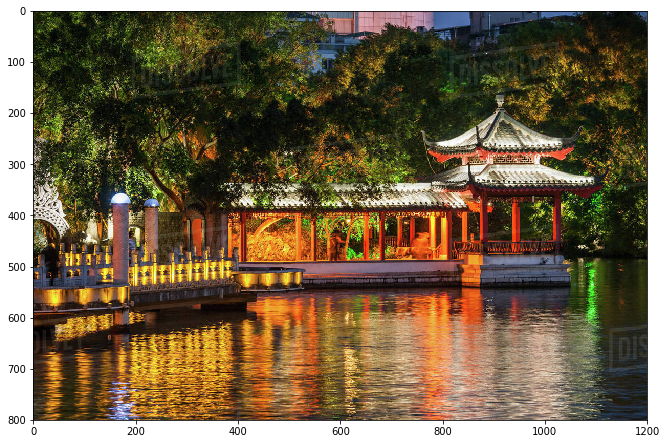

In [15]:
data = scipy.io.loadmat('./imagenet-vgg-verydeep-19.mat')

image_content = scipy.misc.imread('./images/'+content_file_name)
#image_content= scipy.misc.imresize(image_content,(224,224))
plt.figure(figsize=(11,11))
plt.imshow(image_content)
image_content = image_content.astype('float32')
image_content = np.ndarray.reshape(image_content,((1,) + image_content.shape)) # 1 means batch_size
#image_content = np.ndarray.reshape(image_content.shape + (1,)) it is needed to handle gray scale image 


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


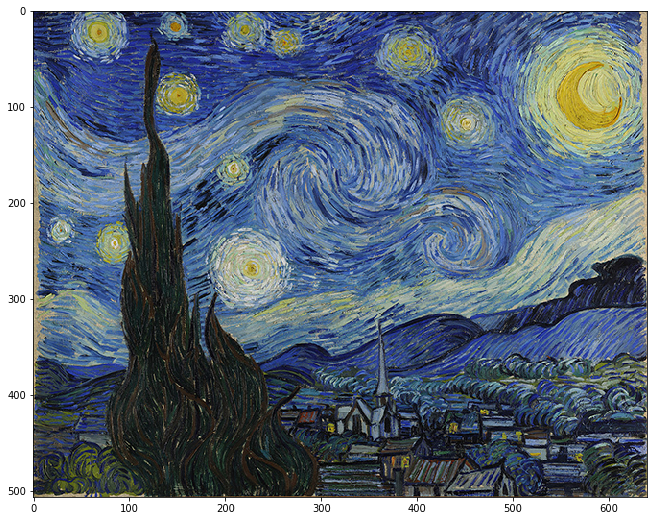

In [16]:
image_style = scipy.misc.imread('./images/'+style_file_name)
#image_style= scipy.misc.imresize(image_style,(224,224))
plt.figure(figsize=(11,11))
plt.imshow(image_style)
image_style = image_style.astype('float32')
image_style = np.ndarray.reshape(image_style,((1,) + image_style.shape)) # 1 means batch_size
#image_style = np.ndarray.reshape(image_style.shape + (1,)) it is needed to handle gray scale image 

In [17]:
print(image_content.shape)
print(image_style.shape)

(1, 800, 1200, 3)
(1, 507, 640, 3)


In [0]:
def _conv_layer(input, weights, bias):
    conv = tf.nn.conv2d(input, tf.constant(weights), strides=(1, 1, 1, 1),
            padding='SAME')
    return tf.nn.bias_add(conv, bias)

def _pool_layer(input):
    return tf.nn.max_pool(input, ksize=(1, 2, 2, 1), strides=(1, 2, 2, 1),
            padding='SAME')

def preprocess(image, mean_pixel):
    return (image - mean_pixel).astype('float32')

def unprocess(image, mean_pixel):
    return (image + mean_pixel).astype('float32')

Creating a network with tensorflow:

In [0]:
def net(input_image):
    layers = (
        'conv1_1', 'relu1_1', 'conv1_2', 'relu1_2', 'pool1',

        'conv2_1', 'relu2_1', 'conv2_2', 'relu2_2', 'pool2',

        'conv3_1', 'relu3_1', 'conv3_2', 'relu3_2', 'conv3_3',
        'relu3_3', 'conv3_4', 'relu3_4', 'pool3',

        'conv4_1', 'relu4_1', 'conv4_2', 'relu4_2', 'conv4_3',
        'relu4_3', 'conv4_4', 'relu4_4', 'pool4',

        'conv5_1', 'relu5_1', 'conv5_2', 'relu5_2', 'conv5_3',
        'relu5_3', 'conv5_4', 'relu5_4'
    )

    weights = data['layers'][0]
    
    net = {}
    current = input_image
    for i, name in enumerate(layers):
        print(i,name)
        kind = name[:4]
        if kind == 'conv':
            kernels, bias = weights[i][0][0][0][0]
            # matconvnet: weights are [width, height, in_channels, out_channels]
            # tensorflow: weights are [height, width, in_channels, out_channels]
         

            kernels = np.transpose(kernels, (1, 0, 2, 3))
            #print('kernel:', kernels.shape)
            #print('bias:', bias.shape)
            
            bias = bias.reshape(-1)
            current = _conv_layer(current, kernels, bias)
            #print('current:', current)
            
        elif kind == 'relu':
            current = tf.nn.relu(current)
            #print('current:', current)
        elif kind == 'pool':
            current = _pool_layer(current)
            #print('current:', current)
        net[name] = current
        #print(' ')

    assert len(net) == len(layers)
    return net#, mean_pixel

Creating the same network with keras

In [0]:
def keras_model(input_image):
    layers = (
        'conv1_1', 'relu1_1', 'conv1_2', 'relu1_2', 'pool1',

        'conv2_1', 'relu2_1', 'conv2_2', 'relu2_2', 'pool2',

        'conv3_1', 'relu3_1', 'conv3_2', 'relu3_2', 'conv3_3',
        'relu3_3', 'conv3_4', 'relu3_4', 'pool3',

        'conv4_1', 'relu4_1', 'conv4_2', 'relu4_2', 'conv4_3',
        'relu4_3', 'conv4_4', 'relu4_4', 'pool4',

        'conv5_1', 'relu5_1', 'conv5_2', 'relu5_2', 'conv5_3',
        'relu5_3', 'conv5_4', 'relu5_4'
    )

    weights = data['layers'][0]
    
    model = Sequential()
    
    current = input_image
    for i, name in enumerate(layers):
        print(i,name)
        kind = name[:4]
        if kind == 'conv':
            kernels, bias = weights[i][0][0][0][0]
            print(kernels.shape, bias.shape)
            # matconvnet: weights are [width, height, in_channels, out_channels]
            # tensorflow: weights are [height, width, in_channels, out_channels]
                 
            #kernels_keras = np.transpose(kernels, (3,2,1, 0))
            kernels_keras = np.transpose(kernels, (1,0,2,3))
           
            if i==0:
                model.add(ZeroPadding2D((1,1),data_format="channels_first",input_shape=(input_image.shape[3],input_image.shape[1],input_image.shape[2])))
            else:
                model.add(ZeroPadding2D((1,1),data_format="channels_first"))
            
            print(model.layers[i].input)
            print(model.layers[i].output)
            model.add(Conv2D(bias.size, (3, 3), name=name, data_format="channels_first", weights=[kernels_keras,bias[0]])) 
            
            #model.add(Conv2D)
            #keras.layers.Conv2D(filters, kernel_size, strides=(1, 1), padding='valid', data_format=None, 
            #                    dilation_rate=(1, 1), 
            #                    activation=None, use_bias=True, kernel_initializer='glorot_uniform', 
            #                    bias_initializer='zeros',
            #                    kernel_regularizer=None, 
            #                    bias_regularizer=None, activity_regularizer=None, kernel_constraint=None, 
            #                    bias_constraint=None)
        elif kind == 'relu':
            model.add(Activation('relu', name=name))
        elif kind == 'pool':
            model.add(MaxPooling2D((2,2), data_format="channels_first", name=name, border_mode='same', strides=(2,2)))
             
    return model 

Calculating the mean pixel values of the VGG network. We will use these values for normalization.

In [22]:
data['normalization'][0][0][0].shape

(224, 224, 3)

In [0]:
mean = data['normalization'][0][0][0]
mean_pixel = np.mean(mean, axis=(0, 1))

In [24]:
mean_pixel

array([123.68 , 116.779, 103.939])

Let us preprocess the content image

In [0]:
content_pre = preprocess(image_content, mean_pixel)

Calculate the activities of the VGG net on the content_pre image:

In [26]:
content_pre.shape

(1, 800, 1200, 3)

In [27]:
content_keras_model = keras_model(content_pre)

W0619 22:46:09.105058 140205354940288 deprecation_wrapper.py:119] From /usr/local/lib/python2.7/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0619 22:46:09.141891 140205354940288 deprecation_wrapper.py:119] From /usr/local/lib/python2.7/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0619 22:46:09.154352 140205354940288 deprecation_wrapper.py:119] From /usr/local/lib/python2.7/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0619 22:46:09.166963 140205354940288 deprecation_wrapper.py:119] From /usr/local/lib/python2.7/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0619 22:46:09.167752 1402053549

(0, 'conv1_1')
((3, 3, 3, 64), (1, 64))
Tensor("zero_padding2d_1_input:0", shape=(?, 3, 800, 1200), dtype=float32)
Tensor("zero_padding2d_1/Pad:0", shape=(?, 3, 802, 1202), dtype=float32)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool1")`
W0619 22:46:11.797560 140205354940288 deprecation_wrapper.py:119] From /usr/local/lib/python2.7/dist-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.



(1, 'relu1_1')
(2, 'conv1_2')
((3, 3, 64, 64), (1, 64))
Tensor("conv1_1/BiasAdd:0", shape=(?, 64, 800, 1200), dtype=float32)
Tensor("relu1_1/Relu:0", shape=(?, 64, 800, 1200), dtype=float32)
(3, 'relu1_2')
(4, 'pool1')
(5, 'conv2_1')
((3, 3, 64, 128), (1, 128))
Tensor("conv1_2/BiasAdd:0", shape=(?, 64, 800, 1200), dtype=float32)
Tensor("relu1_2/Relu:0", shape=(?, 64, 800, 1200), dtype=float32)
(6, 'relu2_1')
(7, 'conv2_2')
((3, 3, 128, 128), (1, 128))
Tensor("pool1/MaxPool:0", shape=(?, 64, 400, 600), dtype=float32)
Tensor("zero_padding2d_3/Pad:0", shape=(?, 64, 402, 602), dtype=float32)
(8, 'relu2_2')
(9, 'pool2')
(10, 'conv3_1')
((3, 3, 128, 256), (1, 256))
Tensor("relu2_1/Relu:0", shape=(?, 128, 400, 600), dtype=float32)
Tensor("zero_padding2d_4/Pad:0", shape=(?, 128, 402, 602), dtype=float32)
(11, 'relu3_1')
(12, 'conv3_2')
((3, 3, 256, 256), (1, 256))
Tensor("conv2_2/BiasAdd:0", shape=(?, 128, 400, 600), dtype=float32)
Tensor("relu2_2/Relu:0", shape=(?, 128, 400, 600), dtype=float

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool2")`


(13, 'relu3_2')
(14, 'conv3_3')
((3, 3, 256, 256), (1, 256))
Tensor("pool2/MaxPool:0", shape=(?, 128, 200, 300), dtype=float32)
Tensor("zero_padding2d_5/Pad:0", shape=(?, 128, 202, 302), dtype=float32)
(15, 'relu3_3')
(16, 'conv3_4')
((3, 3, 256, 256), (1, 256))
Tensor("conv3_1/BiasAdd:0", shape=(?, 256, 200, 300), dtype=float32)
Tensor("relu3_1/Relu:0", shape=(?, 256, 200, 300), dtype=float32)
(17, 'relu3_4')
(18, 'pool3')
(19, 'conv4_1')
((3, 3, 256, 512), (1, 512))
Tensor("conv3_2/BiasAdd:0", shape=(?, 256, 200, 300), dtype=float32)
Tensor("relu3_2/Relu:0", shape=(?, 256, 200, 300), dtype=float32)
(20, 'relu4_1')
(21, 'conv4_2')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_7/Pad:0", shape=(?, 256, 202, 302), dtype=float32)
Tensor("conv3_3/BiasAdd:0", shape=(?, 256, 200, 300), dtype=float32)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool3")`


(22, 'relu4_2')
(23, 'conv4_3')
((3, 3, 512, 512), (1, 512))
Tensor("relu3_3/Relu:0", shape=(?, 256, 200, 300), dtype=float32)
Tensor("zero_padding2d_8/Pad:0", shape=(?, 256, 202, 302), dtype=float32)
(24, 'relu4_3')
(25, 'conv4_4')
((3, 3, 512, 512), (1, 512))
Tensor("conv3_4/BiasAdd:0", shape=(?, 256, 200, 300), dtype=float32)
Tensor("relu3_4/Relu:0", shape=(?, 256, 200, 300), dtype=float32)
(26, 'relu4_4')
(27, 'pool4')
(28, 'conv5_1')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_9/Pad:0", shape=(?, 256, 102, 152), dtype=float32)
Tensor("conv4_1/BiasAdd:0", shape=(?, 512, 100, 150), dtype=float32)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool4")`


(29, 'relu5_1')
(30, 'conv5_2')
((3, 3, 512, 512), (1, 512))
Tensor("relu4_1/Relu:0", shape=(?, 512, 100, 150), dtype=float32)
Tensor("zero_padding2d_10/Pad:0", shape=(?, 512, 102, 152), dtype=float32)
(31, 'relu5_2')
(32, 'conv5_3')
((3, 3, 512, 512), (1, 512))
Tensor("conv4_2/BiasAdd:0", shape=(?, 512, 100, 150), dtype=float32)
Tensor("relu4_2/Relu:0", shape=(?, 512, 100, 150), dtype=float32)
(33, 'relu5_3')
(34, 'conv5_4')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_11/Pad:0", shape=(?, 512, 102, 152), dtype=float32)
Tensor("conv4_3/BiasAdd:0", shape=(?, 512, 100, 150), dtype=float32)
(35, 'relu5_4')


In [28]:
content_keras_model

In [29]:
content = net(content_pre)

(0, 'conv1_1')
(1, 'relu1_1')
(2, 'conv1_2')
(3, 'relu1_2')
(4, 'pool1')
(5, 'conv2_1')
(6, 'relu2_1')
(7, 'conv2_2')
(8, 'relu2_2')
(9, 'pool2')
(10, 'conv3_1')
(11, 'relu3_1')
(12, 'conv3_2')
(13, 'relu3_2')
(14, 'conv3_3')
(15, 'relu3_3')
(16, 'conv3_4')
(17, 'relu3_4')
(18, 'pool3')
(19, 'conv4_1')
(20, 'relu4_1')
(21, 'conv4_2')
(22, 'relu4_2')
(23, 'conv4_3')
(24, 'relu4_3')
(25, 'conv4_4')
(26, 'relu4_4')
(27, 'pool4')
(28, 'conv5_1')
(29, 'relu5_1')
(30, 'conv5_2')
(31, 'relu5_2')
(32, 'conv5_3')
(33, 'relu5_3')
(34, 'conv5_4')
(35, 'relu5_4')


In [30]:
content_keras_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
zero_padding2d_1 (ZeroPaddin (None, 3, 802, 1202)      0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 64, 800, 1200)     1792      
_________________________________________________________________
relu1_1 (Activation)         (None, 64, 800, 1200)     0         
_________________________________________________________________
zero_padding2d_2 (ZeroPaddin (None, 64, 802, 1202)     0         
_________________________________________________________________
conv1_2 (Conv2D)             (None, 64, 800, 1200)     36928     
_________________________________________________________________
relu1_2 (Activation)         (None, 64, 800, 1200)     0         
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 64, 400, 600)      0         
__________

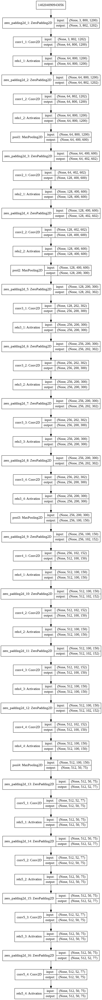

In [31]:
plot_model(content_keras_model, show_shapes=True, to_file='./images/model.png')
Image("./images/model.png")

Select the layers that will be used to get the "content features"

In [0]:
# CONTENT_LAYER = 'relu4_2'
# content_features = {}

# with tf.Session() as sess:
#     content_pre = preprocess(image_content, mean_pixel)
#     content_net = net(np.squeeze(data['layers']), content_pre)
#     content_features[CONTENT_LAYER] = content_net[CONTENT_LAYER].eval()

CONTENT_LAYERS = ('conv1_1', 'conv2_1', 'conv4_1', 'conv4_2')
#CONTENT_LAYERS = ('relu4_2',)
content_features = {}
content_keras_features ={}




In [33]:

for layer in CONTENT_LAYERS:
    # create a temporal subnetwork up to the actual layer 
    tmpmodel=Model(input=content_keras_model.input, output=content_keras_model.get_layer(layer).output) 
    
    # calculate the values of the "content features" features on the content image
    content_keras_features[layer]=np.transpose(tmpmodel.predict(np.transpose(content_pre,(0,3,1,2)) ),(0,2,3,1))
    print('content_keras_feaures shape:', layer, content_keras_features[layer].shape)
   

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("co..., inputs=Tensor("ze...)`
  after removing the cwd from sys.path.


('content_keras_feaures shape:', 'conv1_1', (1, 800, 1200, 64))
('content_keras_feaures shape:', 'conv2_1', (1, 400, 600, 128))
('content_keras_feaures shape:', 'conv4_1', (1, 100, 150, 512))
('content_keras_feaures shape:', 'conv4_2', (1, 100, 150, 512))


In the new image we create, we want to match these content features:

In [0]:
content_features=content_keras_features

Select the layers that will be used to get the "style features"

In [35]:
#STYLE_LAYERS = ('conv3_1','conv5_1')
STYLE_LAYERS = ('relu1_1', 'relu2_1', 'relu3_1', 'relu4_1', 'relu5_1')

style_pre = preprocess(image_style, mean_pixel)
style_keras_model = keras_model(style_pre)

style_keras_features ={}





(0, 'conv1_1')
((3, 3, 3, 64), (1, 64))
Tensor("zero_padding2d_17_input:0", shape=(?, 3, 507, 640), dtype=float32)
Tensor("zero_padding2d_17/Pad:0", shape=(?, 3, 509, 642), dtype=float32)
(1, 'relu1_1')
(2, 'conv1_2')
((3, 3, 64, 64), (1, 64))
Tensor("conv1_1_1/BiasAdd:0", shape=(?, 64, 507, 640), dtype=float32)
Tensor("relu1_1_1/Relu:0", shape=(?, 64, 507, 640), dtype=float32)
(3, 'relu1_2')
(4, 'pool1')
(5, 'conv2_1')
((3, 3, 64, 128), (1, 128))
Tensor("conv1_2_1/BiasAdd:0", shape=(?, 64, 507, 640), dtype=float32)
Tensor("relu1_2_1/Relu:0", shape=(?, 64, 507, 640), dtype=float32)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool1")`
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool2")`


(6, 'relu2_1')
(7, 'conv2_2')
((3, 3, 128, 128), (1, 128))
Tensor("pool1_1/MaxPool:0", shape=(?, 64, 254, 320), dtype=float32)
Tensor("zero_padding2d_19/Pad:0", shape=(?, 64, 256, 322), dtype=float32)
(8, 'relu2_2')
(9, 'pool2')
(10, 'conv3_1')
((3, 3, 128, 256), (1, 256))
Tensor("relu2_1_1/Relu:0", shape=(?, 128, 254, 320), dtype=float32)
Tensor("zero_padding2d_20/Pad:0", shape=(?, 128, 256, 322), dtype=float32)
(11, 'relu3_1')
(12, 'conv3_2')
((3, 3, 256, 256), (1, 256))
Tensor("conv2_2_1/BiasAdd:0", shape=(?, 128, 254, 320), dtype=float32)
Tensor("relu2_2_1/Relu:0", shape=(?, 128, 254, 320), dtype=float32)
(13, 'relu3_2')
(14, 'conv3_3')
((3, 3, 256, 256), (1, 256))
Tensor("pool2_1/MaxPool:0", shape=(?, 128, 127, 160), dtype=float32)
Tensor("zero_padding2d_21/Pad:0", shape=(?, 128, 129, 162), dtype=float32)
(15, 'relu3_3')
(16, 'conv3_4')
((3, 3, 256, 256), (1, 256))
Tensor("conv3_1_1/BiasAdd:0", shape=(?, 256, 127, 160), dtype=float32)
Tensor("relu3_1_1/Relu:0", shape=(?, 256, 127,

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool3")`


(20, 'relu4_1')
(21, 'conv4_2')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_23/Pad:0", shape=(?, 256, 129, 162), dtype=float32)
Tensor("conv3_3_1/BiasAdd:0", shape=(?, 256, 127, 160), dtype=float32)
(22, 'relu4_2')
(23, 'conv4_3')
((3, 3, 512, 512), (1, 512))
Tensor("relu3_3_1/Relu:0", shape=(?, 256, 127, 160), dtype=float32)
Tensor("zero_padding2d_24/Pad:0", shape=(?, 256, 129, 162), dtype=float32)
(24, 'relu4_3')
(25, 'conv4_4')
((3, 3, 512, 512), (1, 512))
Tensor("conv3_4_1/BiasAdd:0", shape=(?, 256, 127, 160), dtype=float32)
Tensor("relu3_4_1/Relu:0", shape=(?, 256, 127, 160), dtype=float32)
(26, 'relu4_4')
(27, 'pool4')
(28, 'conv5_1')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_25/Pad:0", shape=(?, 256, 66, 82), dtype=float32)
Tensor("conv4_1_1/BiasAdd:0", shape=(?, 512, 64, 80), dtype=float32)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:54: UserWarning: Update your `MaxPooling2D` call to the Keras 2 API: `MaxPooling2D((2, 2), padding="same", strides=(2, 2), data_format="channels_first", name="pool4")`


(29, 'relu5_1')
(30, 'conv5_2')
((3, 3, 512, 512), (1, 512))
Tensor("relu4_1_1/Relu:0", shape=(?, 512, 64, 80), dtype=float32)
Tensor("zero_padding2d_26/Pad:0", shape=(?, 512, 66, 82), dtype=float32)
(31, 'relu5_2')
(32, 'conv5_3')
((3, 3, 512, 512), (1, 512))
Tensor("conv4_2_1/BiasAdd:0", shape=(?, 512, 64, 80), dtype=float32)
Tensor("relu4_2_1/Relu:0", shape=(?, 512, 64, 80), dtype=float32)
(33, 'relu5_3')
(34, 'conv5_4')
((3, 3, 512, 512), (1, 512))
Tensor("zero_padding2d_27/Pad:0", shape=(?, 512, 66, 82), dtype=float32)
Tensor("conv4_3_1/BiasAdd:0", shape=(?, 512, 64, 80), dtype=float32)
(35, 'relu5_4')


In [36]:
for layer in STYLE_LAYERS:
    
    # create a temporal subnetwork up to the actual layer 
    tmpmodel=Model(input=style_keras_model.input, output=style_keras_model.get_layer(layer).output) 
    
    # calculate the values of the "style features" features on the style image
    features=np.transpose(tmpmodel.predict(np.transpose(style_pre,(0,3,1,2)) ),(0,2,3,1))
    print('features shape:', layer, features.shape)
    
    # rehape the features
    features = np.reshape(features, (-1, features.shape[3]))
    print('reshaped features shape:', layer, features.shape)
    
    # Create a covraince matrix (Gram matrix) from these features
    gram = np.matmul(features.T, features) / features.size
    style_keras_features[layer] = gram
    print('gram shape:', layer, gram.shape)
    print('**************')
        

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:4: UserWarning: Update your `Model` call to the Keras 2 API: `Model(outputs=Tensor("re..., inputs=Tensor("ze...)`
  after removing the cwd from sys.path.


('features shape:', 'relu1_1', (1, 507, 640, 64))
('reshaped features shape:', 'relu1_1', (324480, 64))
('gram shape:', 'relu1_1', (64, 64))
**************
('features shape:', 'relu2_1', (1, 254, 320, 128))
('reshaped features shape:', 'relu2_1', (81280, 128))
('gram shape:', 'relu2_1', (128, 128))
**************
('features shape:', 'relu3_1', (1, 127, 160, 256))
('reshaped features shape:', 'relu3_1', (20320, 256))
('gram shape:', 'relu3_1', (256, 256))
**************
('features shape:', 'relu4_1', (1, 64, 80, 512))
('reshaped features shape:', 'relu4_1', (5120, 512))
('gram shape:', 'relu4_1', (512, 512))
**************
('features shape:', 'relu5_1', (1, 32, 40, 512))
('reshaped features shape:', 'relu5_1', (1280, 512))
('gram shape:', 'relu5_1', (512, 512))
**************


In the new image we create, we want to match these style features:

In [0]:
style_features=style_keras_features

Create a new initial image. Random noise... or maybe load it from somewhere.

In [0]:
# make stylized image using backpropogation
initial = None
#initial = scipy.misc.imread('./images/cat.jpg')
if initial is None:
    noise = np.random.normal(size=image_content.shape, scale=np.std(image_content) * 0.1)
    initial = tf.random_normal(image_content.shape) * 0.256
else:
    initial = np.array([preprocess(initial, mean_pixel)])
    initial = initial.astype('float32')

Create a new image initialized with the above value. This will be the tensorflow variable that we will update with backpropagation.

In [39]:
image = tf.Variable(initial)
image_net = net(image)


(0, 'conv1_1')
(1, 'relu1_1')
(2, 'conv1_2')
(3, 'relu1_2')
(4, 'pool1')
(5, 'conv2_1')
(6, 'relu2_1')
(7, 'conv2_2')
(8, 'relu2_2')
(9, 'pool2')
(10, 'conv3_1')
(11, 'relu3_1')
(12, 'conv3_2')
(13, 'relu3_2')
(14, 'conv3_3')
(15, 'relu3_3')
(16, 'conv3_4')
(17, 'relu3_4')
(18, 'pool3')
(19, 'conv4_1')
(20, 'relu4_1')
(21, 'conv4_2')
(22, 'relu4_2')
(23, 'conv4_3')
(24, 'relu4_3')
(25, 'conv4_4')
(26, 'relu4_4')
(27, 'pool4')
(28, 'conv5_1')
(29, 'relu5_1')
(30, 'conv5_2')
(31, 'relu5_2')
(32, 'conv5_3')
(33, 'relu5_3')
(34, 'conv5_4')
(35, 'relu5_4')


Set up the parameters. Feel free to change them.

In [0]:
#content_weight = 5e0
#style_weight = 1e4
#tv_weight = 1e3
#learning_rate = 1e0

content_weight= 5e0
style_weight= 1e2
tv_weight = 1e2
learning_rate = 1e1

iterations =  1000
checkpoint_iterations = 20
print_iterations = 10


Create the content loss function. 

It measure how much the content features of the tensorflow variable "image" deviate from the content features of the content image.

In [0]:
# content loss
# content_loss = content_weight * (2 * tf.nn.l2_loss(
#         image_net[CONTENT_LAYER] - content_features[CONTENT_LAYER]) / 
#         content_features[CONTENT_LAYER].size)
content_loss = 0
content_losses = []
for content_layer in CONTENT_LAYERS:
    content_losses.append(2 * tf.nn.l2_loss(
                          image_net[content_layer] - content_features[content_layer]) / 
                          content_features[content_layer].size)
content_loss += content_weight * reduce(tf.add, content_losses)

In [42]:
content_loss

<tf.Tensor 'add_3:0' shape=() dtype=float32>

Create the style loss function.
It measure how much the style Gram matrices of the tensorflow variable "image" deviate from the style Gram matrices of the style image.

In [0]:
# style loss
style_loss = 0
style_losses = []
for style_layer in STYLE_LAYERS:
    layer = image_net[style_layer]
    _, height, width, number = map(lambda i: i.value, layer.get_shape())
    size = height * width * number
    feats = tf.reshape(layer, (-1, number))
    gram = tf.matmul(tf.transpose(feats), feats) / size
    style_gram = style_features[style_layer]
    style_losses.append(2 * tf.nn.l2_loss(gram - style_gram) / style_gram.size)
style_loss += style_weight * reduce(tf.add, style_losses)

In [44]:
style_loss

<tf.Tensor 'add_8:0' shape=() dtype=float32>

In [0]:
def _tensor_size(tensor):
    from operator import mul
    return reduce(mul, (d.value for d in tensor.get_shape()), 1)

Create a Total Variation loss function

In [0]:
# total variation denoising
tv_y_size = _tensor_size(image[:,1:,:,:])
tv_x_size = _tensor_size(image[:,:,1:,:])
tv_loss = tv_weight * 2 * (
        (tf.nn.l2_loss(image[:,1:,:,:] - image[:,:image_content.shape[1]-1,:,:]) /
            tv_y_size) +
        (tf.nn.l2_loss(image[:,:,1:,:] - image[:,:,:image_content.shape[2]-1,:]) /
            tv_x_size))

In [47]:
print(image)

<tf.Variable 'Variable:0' shape=(1, 800, 1200, 3) dtype=float32_ref>


The final loss function is the sum of the content_loss, style_loss, and tv_loss functions.

In [0]:
# overall loss
loss = content_loss + style_loss + tv_loss

Set Adam to minimize the final loss function

In [0]:
# optimizer setup
train_step = tf.train.AdamOptimizer(learning_rate).minimize(loss)

In [0]:
def imsave(path, img):
    img = np.clip(img, 0, 255).astype(np.uint8)
    scipy.misc.imsave(path, img)

OPTIMIZATION STARTS NOW

W0619 22:47:41.589534 140205354940288 deprecation.py:323] From /usr/local/lib/python2.7/dist-packages/tensorflow/python/util/tf_should_use.py:193: initialize_all_variables (from tensorflow.python.ops.variables) is deprecated and will be removed after 2017-03-02.
Instructions for updating:
Use `tf.global_variables_initializer` instead.


0
new minimum found


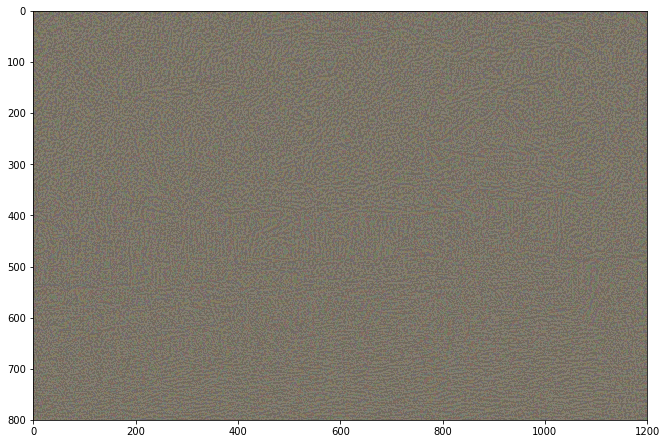

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


Iteration 1/1000
  content loss: 2.16572e+07
    style loss: 7.61615e+07
       tv loss: 21635.3
    total loss: 9.78403e+07
1
2
3
4
5
6
7
8
9
10
Iteration 11/1000
  content loss: 1.53678e+07
    style loss: 8.92114e+06
       tv loss: 250022
    total loss: 2.4539e+07
11
12
13
14
15
16
17
18
19
20
new minimum found


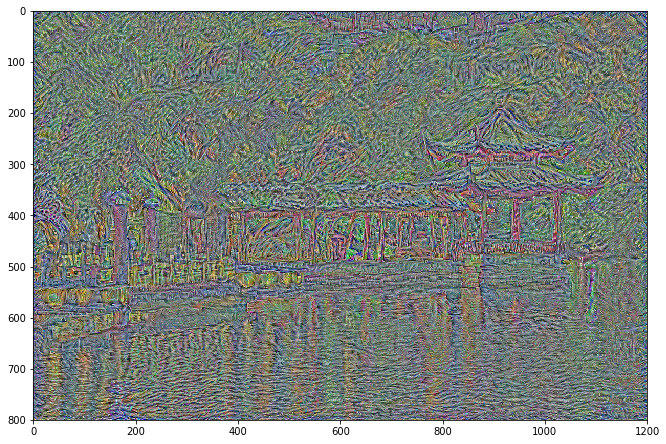

Iteration 21/1000
  content loss: 1.15738e+07
    style loss: 3.93351e+06
       tv loss: 256565
    total loss: 1.57639e+07
21
22
23
24
25
26
27
28
29
30
Iteration 31/1000
  content loss: 9.1709e+06
    style loss: 2.61383e+06
       tv loss: 226128
    total loss: 1.20109e+07
31
32
33
34
35
36
37
38
39
40
new minimum found


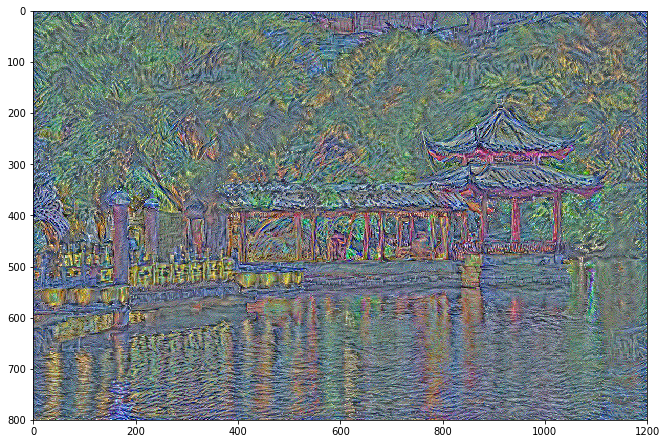

Iteration 41/1000
  content loss: 7.87151e+06
    style loss: 2.1403e+06
       tv loss: 205889
    total loss: 1.02177e+07
41
42
43
44
45
46
47
48
49
50
Iteration 51/1000
  content loss: 7.11637e+06
    style loss: 1.93494e+06
       tv loss: 193059
    total loss: 9.24437e+06
51
52
53
54
55
56
57
58
59
60
new minimum found


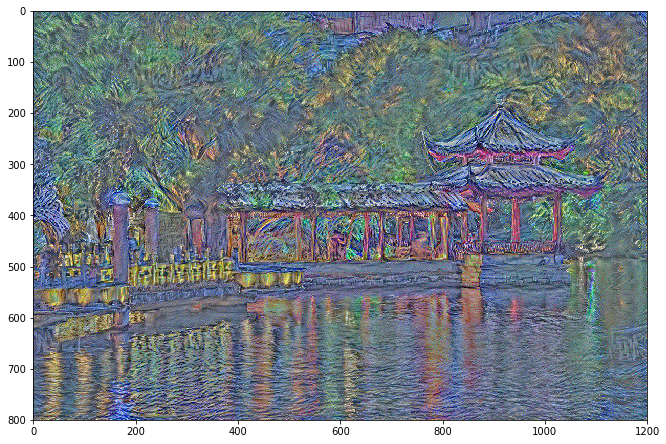

Iteration 61/1000
  content loss: 6.65804e+06
    style loss: 1.823e+06
       tv loss: 182901
    total loss: 8.66394e+06
61
62
63
64
65
66
67
68
69
70
Iteration 71/1000
  content loss: 6.36657e+06
    style loss: 1.74837e+06
       tv loss: 174208
    total loss: 8.28915e+06
71
72
73
74
75
76
77
78
79
80
new minimum found


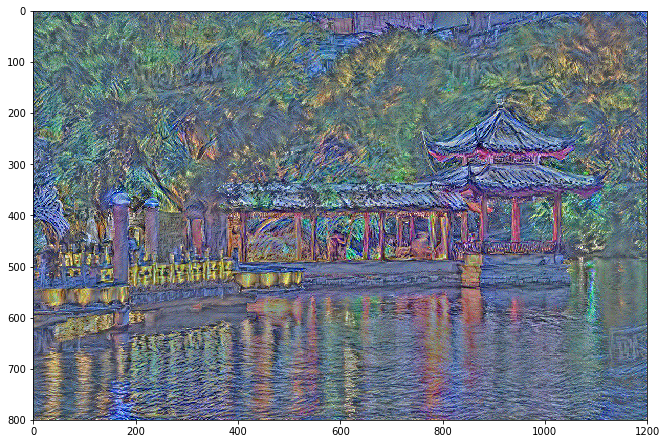

Iteration 81/1000
  content loss: 6.23259e+06
    style loss: 1.67429e+06
       tv loss: 166896
    total loss: 8.07377e+06
81
82
83
84
85
86
87
88
89
90
Iteration 91/1000
  content loss: 6.14568e+06
    style loss: 1.67283e+06
       tv loss: 161684
    total loss: 7.9802e+06
91
92
93
94
95
96
97
98
99
100
new minimum found


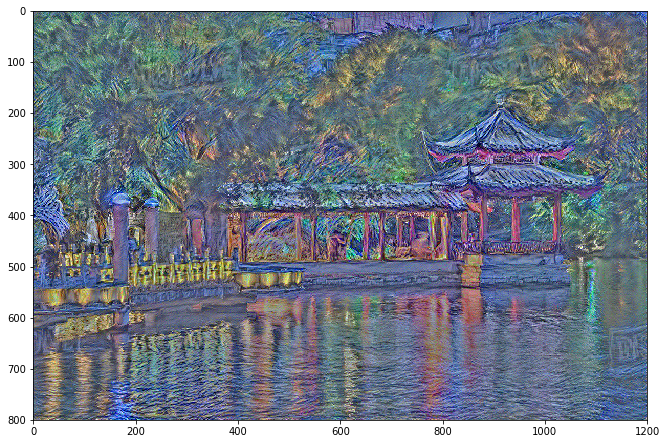

Iteration 101/1000
  content loss: 5.89051e+06
    style loss: 1.72542e+06
       tv loss: 155479
    total loss: 7.77141e+06
101
102
103
104
105
106
107
108
109
110
Iteration 111/1000
  content loss: 5.76822e+06
    style loss: 1.72217e+06
       tv loss: 150119
    total loss: 7.64052e+06
111
112
113
114
115
116
117
118
119
120
new minimum found


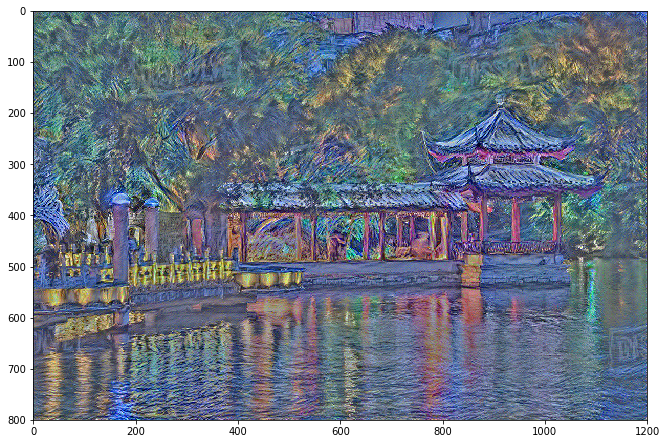

Iteration 121/1000
  content loss: 5.77244e+06
    style loss: 1.63016e+06
       tv loss: 145827
    total loss: 7.54842e+06
121
122
123
124
125
126
127
128
129
130
Iteration 131/1000
  content loss: 5.66124e+06
    style loss: 1.70268e+06
       tv loss: 142826
    total loss: 7.50674e+06
131
132
133
134
135
136
137
138
139
140
new minimum found


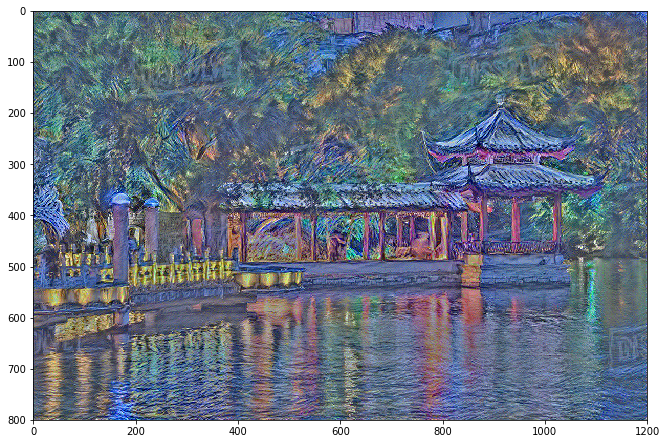

Iteration 141/1000
  content loss: 5.66521e+06
    style loss: 1.63587e+06
       tv loss: 139179
    total loss: 7.44025e+06
141
142
143
144
145
146
147
148
149
150
Iteration 151/1000
  content loss: 5.4973e+06
    style loss: 1.75562e+06
       tv loss: 135341
    total loss: 7.38826e+06
151
152
153
154
155
156
157
158
159
160
Iteration 161/1000
  content loss: 5.80251e+06
    style loss: 1.67893e+06
       tv loss: 134628
    total loss: 7.61607e+06
161
162
163
164
165
166
167
168
169
170
Iteration 171/1000
  content loss: 5.65853e+06
    style loss: 1.594e+06
       tv loss: 132299
    total loss: 7.38483e+06
171
172
173
174
175
176
177
178
179
180
new minimum found


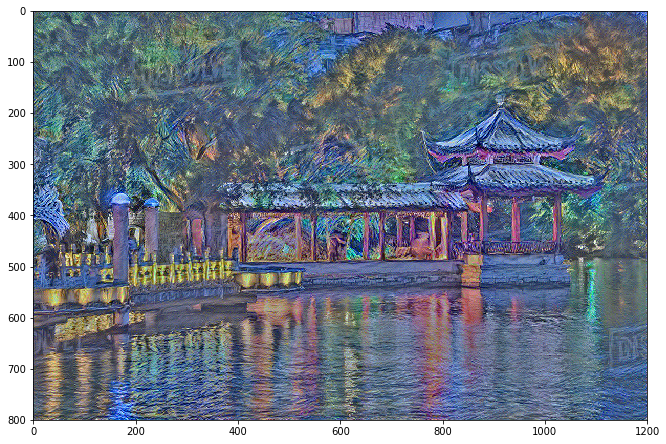

Iteration 181/1000
  content loss: 5.6748e+06
    style loss: 1.50741e+06
       tv loss: 129534
    total loss: 7.31174e+06
181
182
183
184
185
186
187
188
189
190
Iteration 191/1000
  content loss: 5.49636e+06
    style loss: 1.5773e+06
       tv loss: 127409
    total loss: 7.20107e+06
191
192
193
194
195
196
197
198
199
200
new minimum found


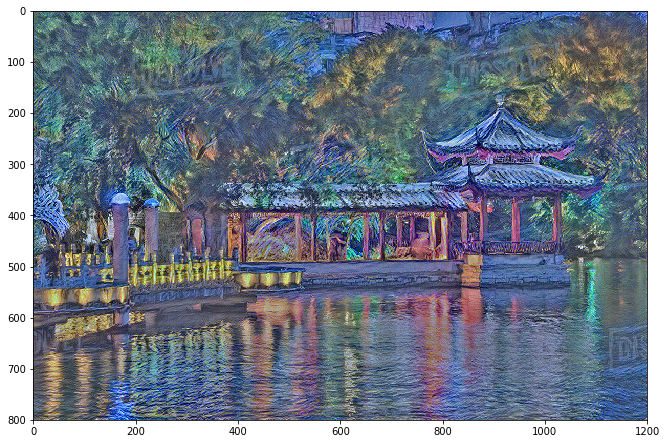

Iteration 201/1000
  content loss: 5.47834e+06
    style loss: 1.64977e+06
       tv loss: 124854
    total loss: 7.25296e+06
201
202
203
204
205
206
207
208
209
210
Iteration 211/1000
  content loss: 5.83461e+06
    style loss: 1.54192e+06
       tv loss: 126468
    total loss: 7.50299e+06
211
212
213
214
215
216
217
218
219
220
Iteration 221/1000
  content loss: 5.45487e+06
    style loss: 1.81604e+06
       tv loss: 125941
    total loss: 7.39686e+06
221
222
223
224
225
226
227
228
229
230
Iteration 231/1000
  content loss: 5.46452e+06
    style loss: 1.59795e+06
       tv loss: 122696
    total loss: 7.18517e+06
231
232
233
234
235
236
237
238
239
240
Iteration 241/1000
  content loss: 5.14577e+06
    style loss: 2.30845e+06
       tv loss: 119869
    total loss: 7.57409e+06
241
242
243
244
245
246
247
248
249
250
Iteration 251/1000
  content loss: 5.43907e+06
    style loss: 1.78845e+06
       tv loss: 123834
    total loss: 7.35135e+06
251
252
253
254
255
256
257
258
259
260
Iter

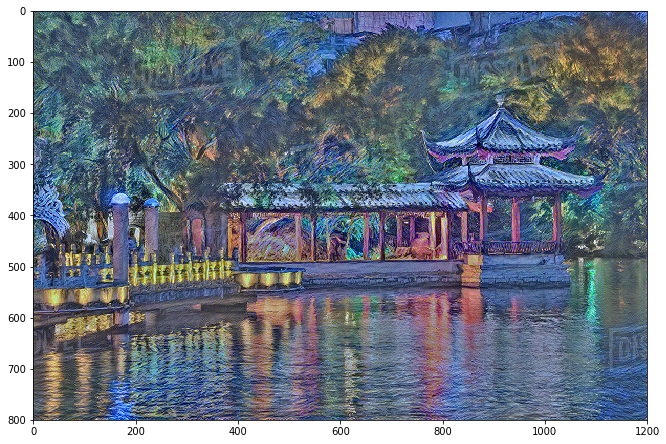

Iteration 281/1000
  content loss: 5.28516e+06
    style loss: 1.60834e+06
       tv loss: 116531
    total loss: 7.01004e+06
281
282
283
284
285
286
287
288
289
290
Iteration 291/1000
  content loss: 5.23858e+06
    style loss: 1.76001e+06
       tv loss: 115498
    total loss: 7.11409e+06
291
292
293
294
295
296
297
298
299
300
Iteration 301/1000
  content loss: 5.47516e+06
    style loss: 1.52172e+06
       tv loss: 116118
    total loss: 7.11299e+06
301
302
303
304
305
306
307
308
309
310
Iteration 311/1000
  content loss: 5.24162e+06
    style loss: 1.73362e+06
       tv loss: 114736
    total loss: 7.08998e+06
311
312
313
314
315
316
317
318
319
320
new minimum found


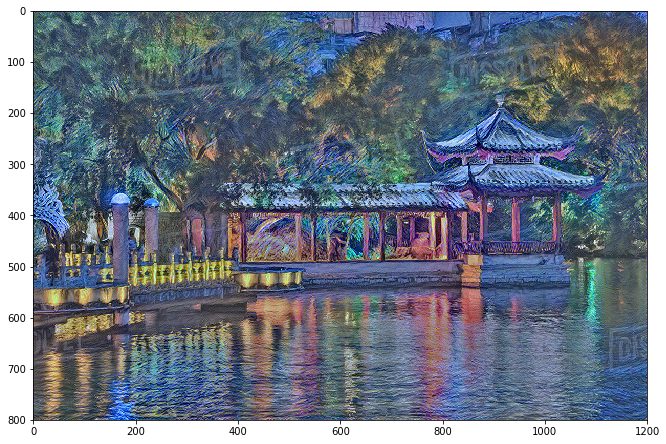

Iteration 321/1000
  content loss: 5.17913e+06
    style loss: 1.67591e+06
       tv loss: 112882
    total loss: 6.96792e+06
321
322
323
324
325
326
327
328
329
330
Iteration 331/1000
  content loss: 5.28212e+06
    style loss: 1.58784e+06
       tv loss: 112238
    total loss: 6.9822e+06
331
332
333
334
335
336
337
338
339
340
new minimum found


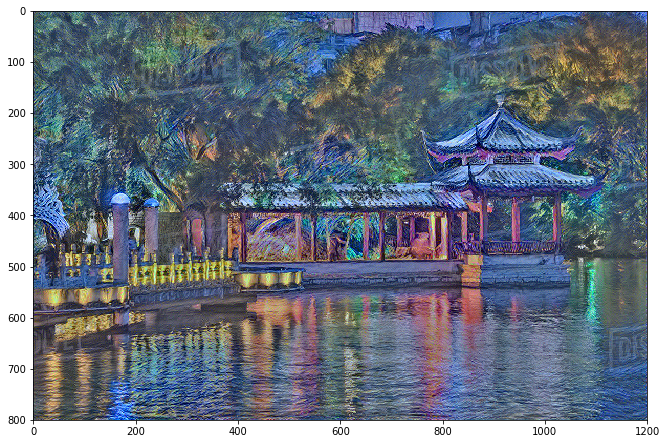

Iteration 341/1000
  content loss: 5.29761e+06
    style loss: 1.50791e+06
       tv loss: 110951
    total loss: 6.91646e+06
341
342
343
344
345
346
347
348
349
350
Iteration 351/1000
  content loss: 5.13728e+06
    style loss: 1.83472e+06
       tv loss: 109979
    total loss: 7.08198e+06
351
352
353
354
355
356
357
358
359
360
Iteration 361/1000
  content loss: 5.29938e+06
    style loss: 1.52671e+06
       tv loss: 110438
    total loss: 6.93652e+06
361
362
363
364
365
366
367
368
369
370
Iteration 371/1000
  content loss: 5.1706e+06
    style loss: 1.64314e+06
       tv loss: 108968
    total loss: 6.9227e+06
371
372
373
374
375
376
377
378
379
380
new minimum found


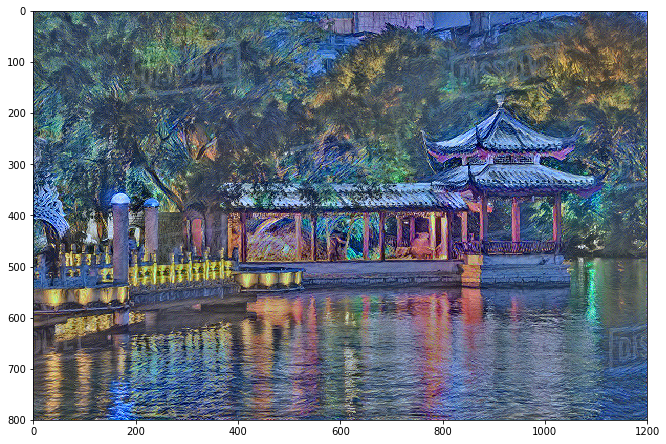

Iteration 381/1000
  content loss: 5.26843e+06
    style loss: 1.50139e+06
       tv loss: 108281
    total loss: 6.8781e+06
381
382
383
384
385
386
387
388
389
390
Iteration 391/1000
  content loss: 5.13286e+06
    style loss: 1.85098e+06
       tv loss: 108194
    total loss: 7.09203e+06
391
392
393
394
395
396
397
398
399
400
Iteration 401/1000
  content loss: 5.53971e+06
    style loss: 2.03682e+06
       tv loss: 113938
    total loss: 7.69046e+06
401
402
403
404
405
406
407
408
409
410
Iteration 411/1000
  content loss: 5.56219e+06
    style loss: 2.54854e+06
       tv loss: 120601
    total loss: 8.23134e+06
411
412
413
414
415
416
417
418
419
420
Iteration 421/1000
  content loss: 5.73725e+06
    style loss: 1.64999e+06
       tv loss: 121320
    total loss: 7.50856e+06
421
422
423
424
425
426
427
428
429
430
Iteration 431/1000
  content loss: 5.38859e+06
    style loss: 1.66458e+06
       tv loss: 116940
    total loss: 7.17011e+06
431
432
433
434
435
436
437
438
439
440
Itera

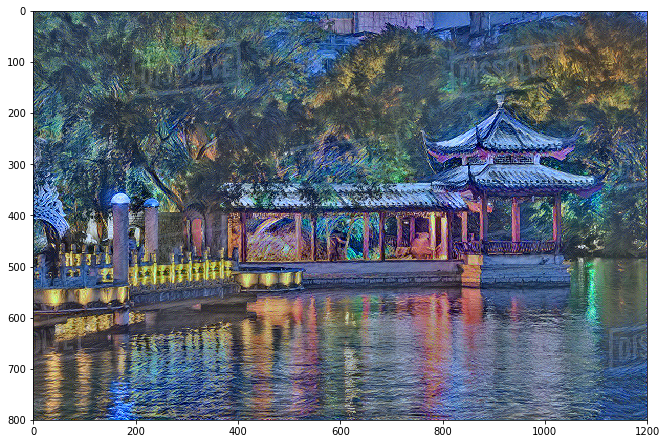

Iteration 501/1000
  content loss: 5.28654e+06
    style loss: 1.46431e+06
       tv loss: 105225
    total loss: 6.85608e+06
501
502
503
504
505
506
507
508
509
510
Iteration 511/1000
  content loss: 5.05292e+06
    style loss: 1.79573e+06
       tv loss: 104828
    total loss: 6.95348e+06
511
512
513
514
515
516
517
518
519
520
new minimum found


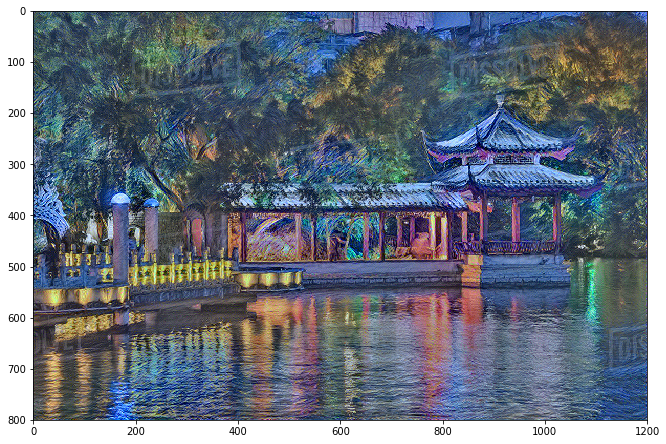

Iteration 521/1000
  content loss: 5.06611e+06
    style loss: 1.64237e+06
       tv loss: 104350
    total loss: 6.81283e+06
521
522
523
524
525
526
527
528
529
530
Iteration 531/1000
  content loss: 5.24107e+06
    style loss: 1.46112e+06
       tv loss: 103696
    total loss: 6.80589e+06
531
532
533
534
535
536
537
538
539
540
new minimum found


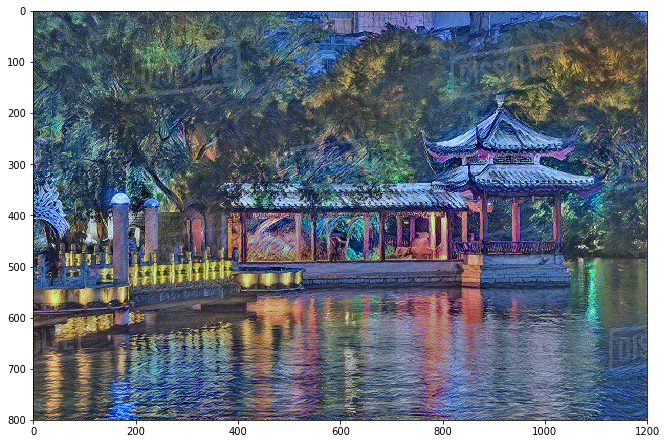

Iteration 541/1000
  content loss: 5.07e+06
    style loss: 1.6036e+06
       tv loss: 102802
    total loss: 6.7764e+06
541
542
543
544
545
546
547
548
549
550
Iteration 551/1000
  content loss: 5.37594e+06
    style loss: 1.82177e+06
       tv loss: 103253
    total loss: 7.30096e+06
551
552
553
554
555
556
557
558
559
560
Iteration 561/1000
  content loss: 5.76547e+06
    style loss: 1.48369e+06
       tv loss: 107936
    total loss: 7.3571e+06
561
562
563
564
565
566
567
568
569
570
Iteration 571/1000
  content loss: 5.48124e+06
    style loss: 1.8951e+06
       tv loss: 112239
    total loss: 7.48858e+06
571
572
573
574
575
576
577
578
579
580
Iteration 581/1000
  content loss: 5.45104e+06
    style loss: 1.84352e+06
       tv loss: 111178
    total loss: 7.40574e+06
581
582
583
584
585
586
587
588
589
590
Iteration 591/1000
  content loss: 5.38058e+06
    style loss: 1.61822e+06
       tv loss: 112340
    total loss: 7.11114e+06
591
592
593
594
595
596
597
598
599
600
Iteration 6

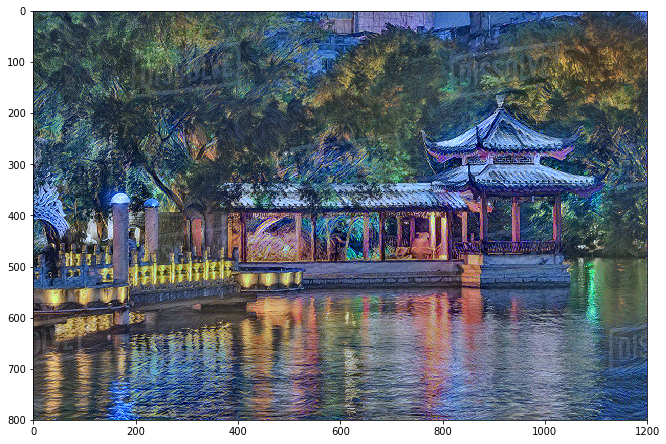

Iteration 901/1000
  content loss: 5.0878e+06
    style loss: 1.57775e+06
       tv loss: 104944
    total loss: 6.7705e+06
901
902
903
904
905
906
907
908
909
910
Iteration 911/1000
  content loss: 4.98808e+06
    style loss: 1.68896e+06
       tv loss: 102876
    total loss: 6.77992e+06
911
912
913
914
915
916
917
918
919
920
Iteration 921/1000
  content loss: 5.03291e+06
    style loss: 1.6371e+06
       tv loss: 102468
    total loss: 6.77248e+06
921
922
923
924
925
926
927
928
929
930
Iteration 931/1000
  content loss: 5.05497e+06
    style loss: 1.56948e+06
       tv loss: 101303
    total loss: 6.72575e+06
931
932
933
934
935
936
937
938
939
940
Iteration 941/1000
  content loss: 5.05476e+06
    style loss: 1.63166e+06
       tv loss: 100293
    total loss: 6.78672e+06
941
942
943
944
945
946
947
948
949
950
Iteration 951/1000
  content loss: 5.06459e+06
    style loss: 1.57363e+06
       tv loss: 100563
    total loss: 6.73879e+06
951
952
953
954
955
956
957
958
959
960
Iterati

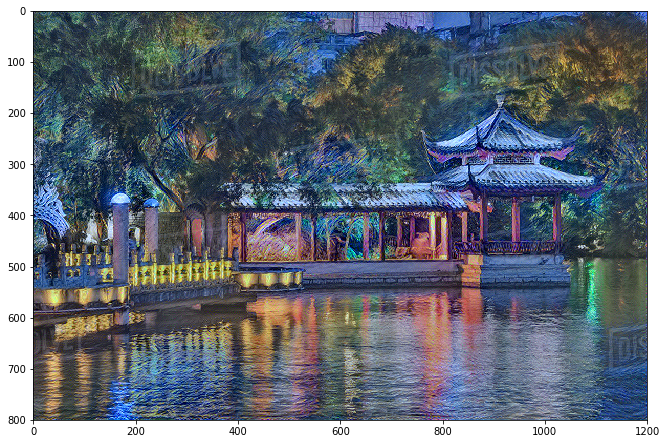

Iteration 981/1000
  content loss: 5.09312e+06
    style loss: 1.56481e+06
       tv loss: 98388.4
    total loss: 6.75632e+06
981
982
983
984
985
986
987
988
989
990
Iteration 991/1000
  content loss: 5.03182e+06
    style loss: 1.57138e+06
       tv loss: 97807.1
    total loss: 6.70101e+06
991
992
993
994
995
996
997
998
999
new minimum found


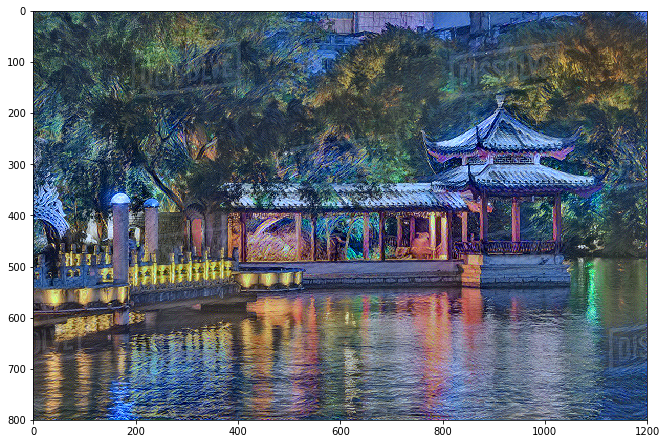

Iteration 1000/1000
  content loss: 4.99121e+06
    style loss: 1.63683e+06
       tv loss: 97644.1
    total loss: 6.72569e+06


In [51]:
# optimization
best_loss = float('inf')
best = None

with tf.Session() as sess:
    sess.run(tf.initialize_all_variables())
    for i in range(iterations):
        print(i)
        
        # the next step is the actual tensorflow training/minimization step
        train_step.run()
        
        # save the images after some iterations
        if i % checkpoint_iterations == 0 or i == iterations - 1:
            this_loss = loss.eval()
            if this_loss < best_loss:
                best_loss = this_loss
                
                # this is the best image so far
                best = image.eval()
                print("new minimum found")
                newimg= unprocess(best.reshape(image_content.shape[1:]), mean_pixel)
                img = np.clip(newimg, 0, 255).astype(np.uint8)
                plt.figure(figsize=(11,11))
                plt.imshow(img)
                plt.show()
                
            
            # save a check point
            import os
            try:
                os.makedirs('./checks/'+str.split(content_file_name,'.')[0])
            except OSError:
                pass
            timestr = time.strftime("%Y%m%d_%H%M%S")
            filename_cp = './checks/'+str.split(content_file_name,'.')[0]+'/'+timestr+'.jpg'
            
            cp = unprocess(best.reshape(image_content.shape[1:]), mean_pixel)
            imsave(filename_cp, cp)
           
        
        if i % print_iterations == 0 or i == iterations - 1:
            print('Iteration %d/%d' % (i + 1, iterations))
            print('  content loss: %g' % content_loss.eval())
            print('    style loss: %g' % style_loss.eval())
            print('       tv loss: %g' % tv_loss.eval())
            print('    total loss: %g' % loss.eval())

    output = unprocess(best.reshape(image_content.shape[1:]), mean_pixel)

In [52]:
imsave('./images/output_'+content_file_name, output)

/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


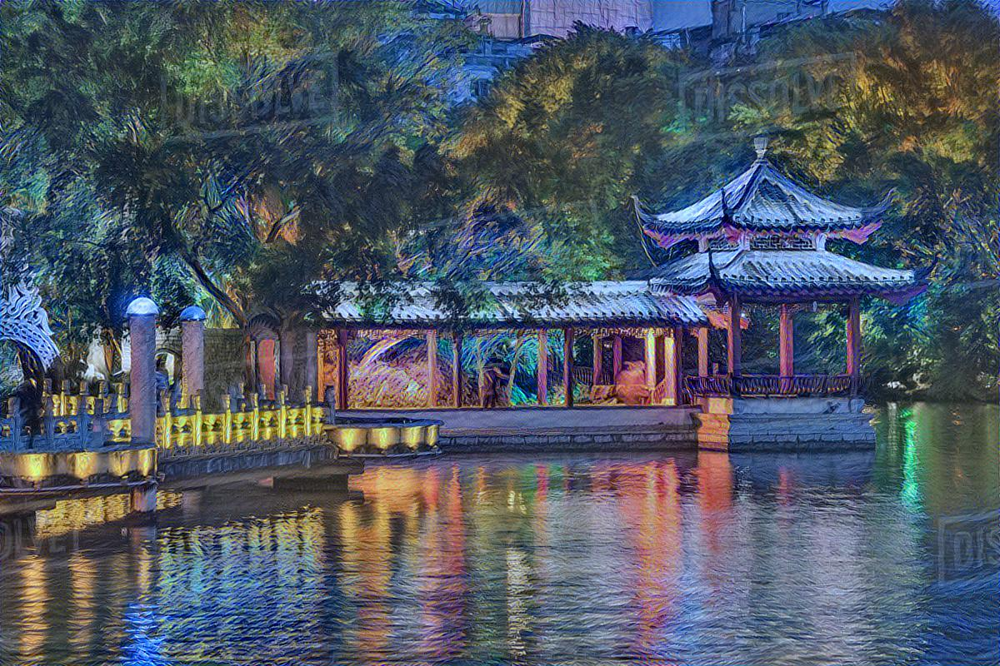

In [53]:
Image(filename = './images/output_'+content_file_name)

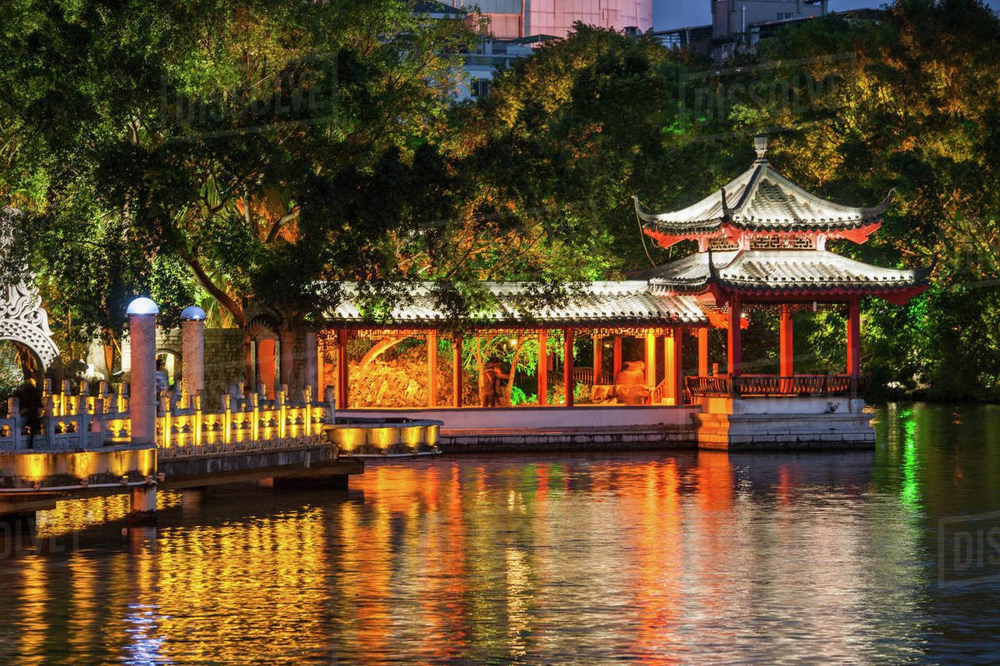

In [54]:
Image(filename = './image.jpg')

In [0]:
!cp image.jpg images